In [2]:
import itertools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

fertility = 'Fertility rate - Sex: all - Age: all - Variant: estimates'
gdp = 'GDP per capita (output, multiple price benchmarks)'
population = 'Population (historical estimates)'

In [7]:
df = pd.read_csv('children-per-woman-fertility-rate-vs-level-of-prosperity.csv')
# cara mengurutkan dari tahun terkecil ke terbesar
dfWorld = df.sort_values(by=['Year'])
# cara outputin semua
pd.set_option('display.max_rows', None)
dfWorld

,Entity,Code,Year,Fertility rate - Sex: all - Age: all - Variant: estimates,"GDP per capita (output, multiple price benchmarks)",Population (historical estimates),Continent
39662,Oman,OMN,-10000,NaN,NaN,2.644000e+03,NaN
37557,Niger,NER,-10000,NaN,NaN,9.543000e+03,NaN
15343,El Salvador,SLV,-10000,NaN,NaN,8.673000e+03,NaN
51672,Tanzania,TZA,-10000,NaN,NaN,7.899000e+03,NaN
41921,Poland,POL,-10000,NaN,NaN,6.990000e+02,NaN
48025,Somalia,SOM,-10000,NaN,NaN,3.470000e+03,NaN
22822,Hong Kong,HKG,-10000,NaN,NaN,1.558000e+03,NaN
3940,Bahamas,BHS,-10000,NaN,NaN,0.000000e+00,NaN
1943,Antigua and Barbuda,ATG,-10000,NaN,NaN,1.000000e+00,NaN
23081,Hungary,HUN,-10000,NaN,NaN,2.109000e+03,NaN


In [6]:
df_clean = df.dropna(subset=[fertility, gdp, population])

[[3159.8088]
 [3214.6665]
 [3267.8481]
 ...
 [3112.875 ]
 [3007.237 ]
 [2787.659 ]]
[[2.90640539]
 [2.91261334]
 [2.9185313 ]
 ...
 [2.90100798]
 [2.88855571]
 [2.86120959]]
Coefficient:  [[-3.54798926]]
Intercept:  [15.19101971]
Correlation Coefficient:  -0.7489979632222933


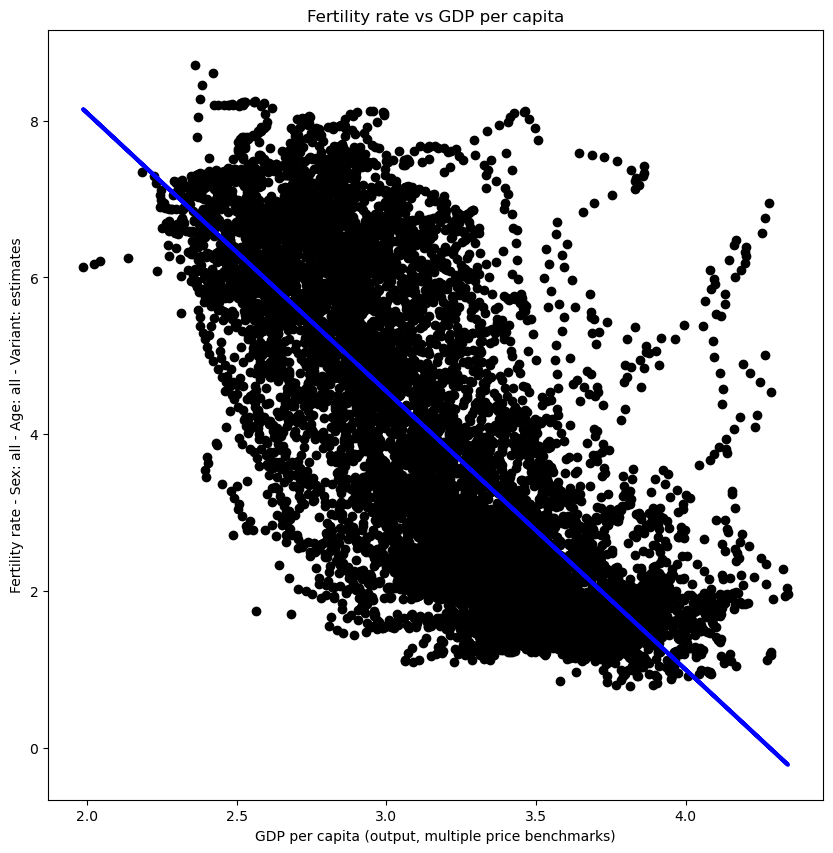

In [20]:
# linear regression
from sklearn.linear_model import LinearRegression
model = LinearRegression()
X = df_clean[gdp].values.reshape(-1, 1)
y = df_clean[fertility].values.reshape(-1, 1)
print(X)
X = np.log2(X) / np.log2(16)
print(X)
model.fit(X, y)

print("Coefficient: ", model.coef_)
print("Intercept: ", model.intercept_)
print("Correlation Coefficient: ", np.corrcoef(X[:,0], y[:,0])[0,1])

# plot
plt.figure(figsize=(10, 10))
plt.scatter(X, y, color='black')
plt.plot(X, model.predict(X), color='blue', linewidth=3)
plt.xlabel(gdp)
plt.ylabel(fertility)
plt.title('Fertility rate vs GDP per capita')
plt.show()